In [1]:
import json
import json
import matplotlib.pyplot as plt
from collections import defaultdict
import re

In [44]:
input_file = 'data.json'
output_file = 'answerlines.json'

with open(input_file, 'r') as file:
    data = json.load(file)

extracted_data = {
    "questions": []
}

for question in data["questions"]:
    new_question = {
        "answer": question["answer"],
        "year": question["year"],
        "category": question["category"],
        "subcategory": question["subcategory"],
        "difficulty": question["difficulty"]
    }
    extracted_data["questions"].append(new_question)

with open(output_file, 'w') as file:
    json.dump(extracted_data, file, indent=4)


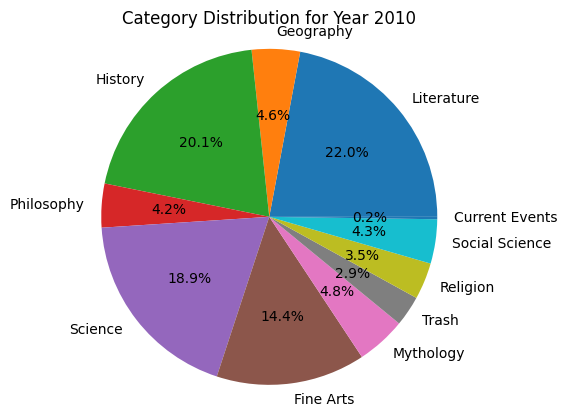

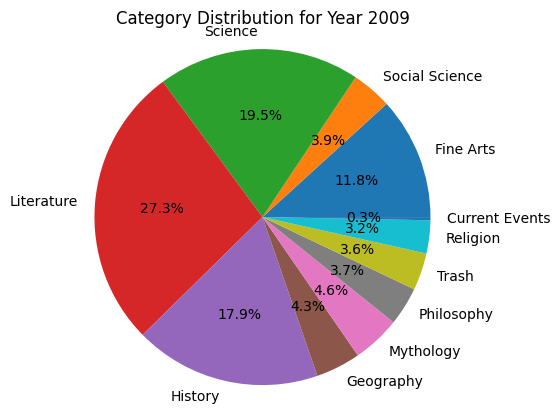

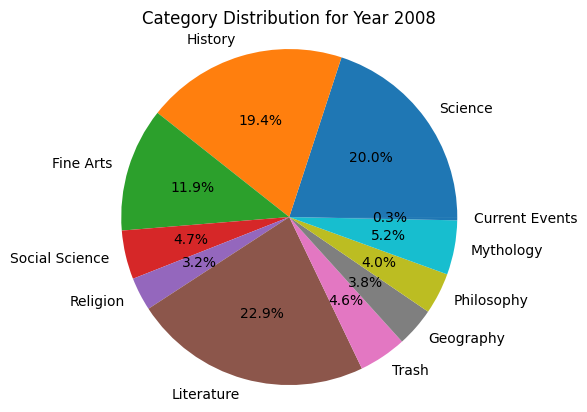

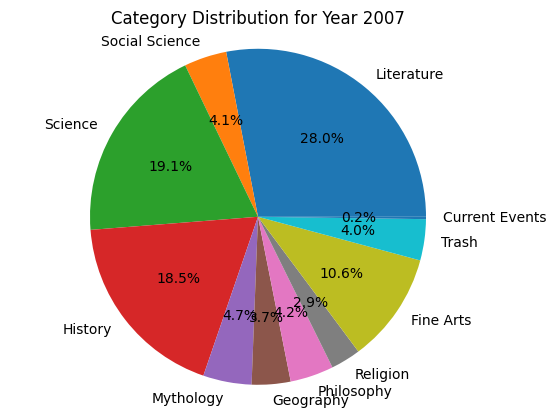

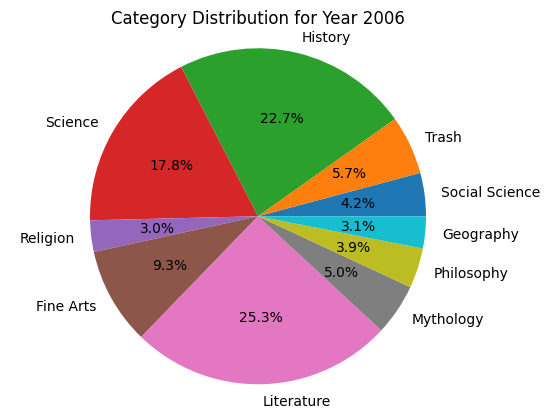

...

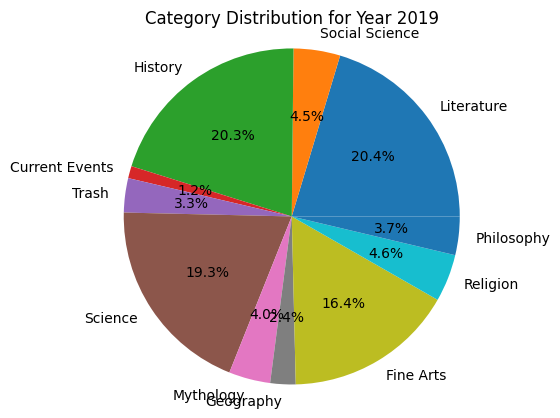

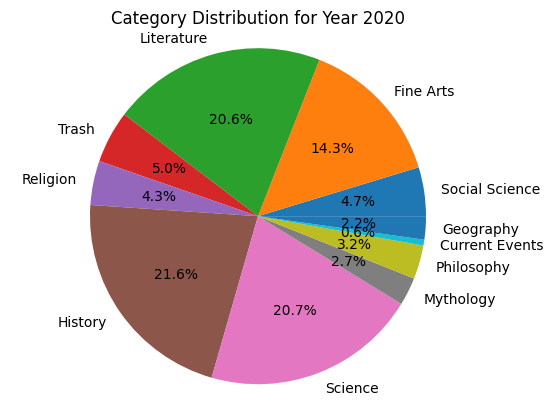

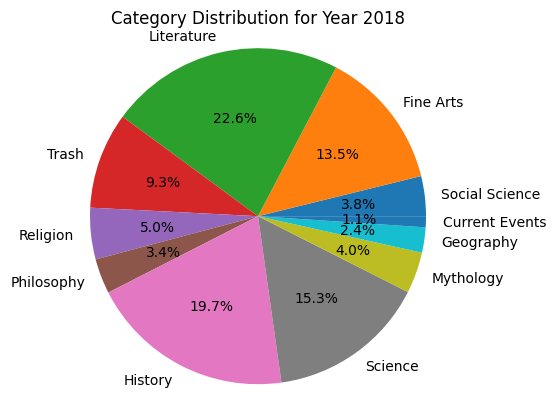

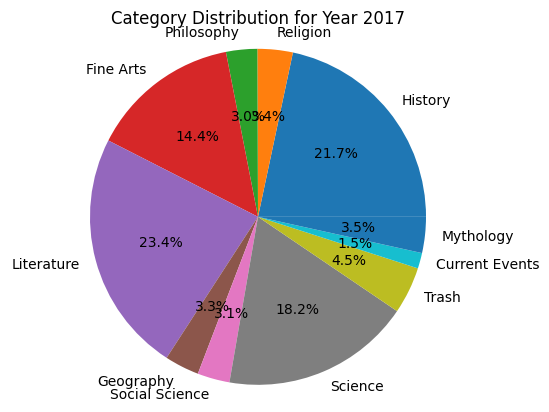

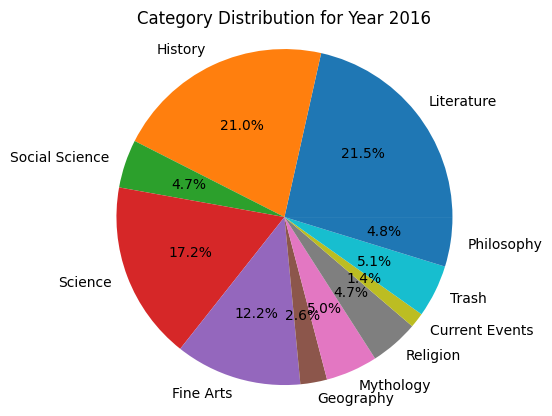

In [2]:
def plot_category_distribution(input_file):
    with open(input_file, 'r') as file:
        data = json.load(file)

    categories_by_year = {}
    for question in data["questions"]:
        year = question["year"]
        category = question["category"]
        if year not in categories_by_year:
            categories_by_year[year] = {}
        if category not in categories_by_year[year]:
            categories_by_year[year][category] = 0
        categories_by_year[year][category] += 1

    for year, categories in categories_by_year.items():
        labels = categories.keys()
        sizes = categories.values()
        plt.figure()
        plt.pie(sizes, labels=labels, autopct='%1.1f%%')
        plt.title(f'Category Distribution for Year {year}')
        plt.axis('equal')  
        plt.show()

plot_category_distribution('answerlines.json')

In [45]:
input_file = 'answerlines.json'
with open(input_file, 'r') as file:
    data = json.load(file)

categories_by_year = {}
for question in data["questions"]:
    year = question["year"]
    category = question["category"]
    if year not in categories_by_year:
        categories_by_year[year] = {}
    if category not in categories_by_year[year]:
        categories_by_year[year][category] = 0
    categories_by_year[year][category] += 1

for year, categories in categories_by_year.items():
    total_questions = sum(categories.values())
    print(f'\nYear {year} Category Percentages:')
    for category, count in categories.items():
        percentage = (count / total_questions) * 100
        print(f"{category}: {percentage:.2f}%")


Year 2010 Category Percentages:
Literature: 22.05%
Geography: 4.64%
History: 20.13%
Philosophy: 4.22%
Science: 18.92%
Fine Arts: 14.35%
Mythology: 4.76%
Trash: 2.93%
Religion: 3.53%
Social Science: 4.26%
Current Events: 0.23%

Year 2009 Category Percentages:
Fine Arts: 11.76%
Social Science: 3.87%
Science: 19.46%
Literature: 27.27%
History: 17.94%
Geography: 4.31%
Mythology: 4.62%
Philosophy: 3.70%
Trash: 3.59%
Religion: 3.18%
Current Events: 0.30%

Year 2008 Category Percentages:
Science: 19.97%
History: 19.38%
Fine Arts: 11.94%
Social Science: 4.70%
Religion: 3.20%
Literature: 22.93%
Trash: 4.60%
Geography: 3.77%
Philosophy: 3.98%
Mythology: 5.23%
Current Events: 0.31%

Year 2007 Category Percentages:
Literature: 28.04%
Social Science: 4.10%
Science: 19.11%
History: 18.49%
Mythology: 4.66%
Geography: 3.73%
Philosophy: 4.18%
Religion: 2.88%
Fine Arts: 10.63%
Trash: 3.96%
Current Events: 0.23%

Year 2006 Category Percentages:
Social Science: 4.16%
Trash: 5.68%
History: 22.73%
Science:

In [13]:
class AnswerLine:
    def __init__(self, value, category, subcategory, difficulty):
        self.value = value
        self.category = category
        self.subcategory = subcategory
        self.total_occurrences = 0
        # self.difficulty = difficulty
        # Initialize occurrences by year from 1997 to 2020 with 0
        self.occurrences_by_year = {year: 0 for year in range(1997, 2021)}

    def add_occurrence(self, year):
        self.total_occurrences += 1
        if year in self.occurrences_by_year:
            self.occurrences_by_year[year] += 1
        else:
            self.occurrences_by_year[year] = 1  # Handle cases outside the initial range

    def __repr__(self):
        return (f"AnswerLine(value={self.value!r}, category={self.category}, subcategory={self.subcategory}, total_occurrences={self.total_occurrences}, "
                f"occurrences_by_year={dict(self.occurrences_by_year)})")

def process_answer_lines(input_file):
    with open(input_file, 'r') as file:
        data = json.load(file)

    answer_lines = {}

    # Regex pattern to remove text within parentheses or square brackets and non-alphanumeric characters, including \xa0
    pattern = re.compile(r'\[.*?\]|\(.*?\)|\\xa0')

    for question in data["questions"]:
        answer = question["answer"].strip().lower()
        answer = pattern.sub('', answer.replace('\xa0', ''))
        answer = re.sub(r'[^\w\s]', '', answer)
        
        answer = answer.strip()
        answer = ' '.join(word for word in answer.split() if not word.startswith('lt')) # handle weird category nonsense
        
        category = question["category"]
        subcategory = question["subcategory"]
        difficulty = question["difficulty"]

        year = question["year"]
        key = (answer, category)
        if key not in answer_lines:
            answer_lines[key] = AnswerLine(answer, category, subcategory, difficulty)
        answer_lines[key].add_occurrence(year)

    return answer_lines

answer_lines = process_answer_lines('answerlines.json')

In [14]:
most_common_answer = None
max_occurrences = 0
for answer_line in answer_lines.values():
    if answer_line.total_occurrences > max_occurrences:
        max_occurrences = answer_line.total_occurrences
        most_common_answer = answer_line

if most_common_answer:
    print(f"The most common answer line is: {most_common_answer}")
else:
    print("No answer lines found.")

The most common answer line is: AnswerLine(value='immanuel kant', category=Philosophy, subcategory=Science Math, total_occurrences=87, occurrences_by_year={1997: 2, 1998: 0, 1999: 0, 2000: 0, 2001: 0, 2002: 1, 2003: 2, 2004: 0, 2005: 0, 2006: 1, 2007: 4, 2008: 4, 2009: 14, 2010: 13, 2011: 9, 2012: 10, 2013: 11, 2014: 7, 2015: 3, 2016: 2, 2017: 1, 2018: 2, 2019: 1, 2020: 0})


In [17]:
for answer in answer_lines.values():
    print(answer)
    with open("parsed_answers.txt", "a") as f:
        f.write(answer.__repr__() + "\n")

AnswerLine(value='queequeg', category=Literature, subcategory=Literature American, total_occurrences=4, occurrences_by_year={1997: 0, 1998: 0, 1999: 0, 2000: 0, 2001: 0, 2002: 0, 2003: 0, 2004: 0, 2005: 0, 2006: 1, 2007: 0, 2008: 0, 2009: 0, 2010: 1, 2011: 1, 2012: 0, 2013: 0, 2014: 0, 2015: 0, 2016: 1, 2017: 0, 2018: 0, 2019: 0, 2020: 0})
AnswerLine(value='dacoromanian', category=Geography, subcategory=Literature European, total_occurrences=1, occurrences_by_year={1997: 0, 1998: 0, 1999: 0, 2000: 0, 2001: 0, 2002: 0, 2003: 0, 2004: 0, 2005: 0, 2006: 0, 2007: 0, 2008: 0, 2009: 0, 2010: 1, 2011: 0, 2012: 0, 2013: 0, 2014: 0, 2015: 0, 2016: 0, 2017: 0, 2018: 0, 2019: 0, 2020: 0})
AnswerLine(value='maine', category=History, subcategory=History American, total_occurrences=7, occurrences_by_year={1997: 0, 1998: 0, 1999: 0, 2000: 0, 2001: 0, 2002: 0, 2003: 0, 2004: 0, 2005: 0, 2006: 0, 2007: 0, 2008: 1, 2009: 1, 2010: 1, 2011: 0, 2012: 0, 2013: 0, 2014: 2, 2015: 1, 2016: 1, 2017: 0, 2018: 0,

In [80]:
repeat_across_years = {"1997-2002":[]}

for i in range (1997, 2016):
    label = str(i) + "-" + str(i+5)
    repeat_across_years[label] = []

print(repeat_across_years)

{'1997-2002': [], '1998-2003': [], '1999-2004': [], '2000-2005': [], '2001-2006': [], '2002-2007': [], '2003-2008': [], '2004-2009': [], '2005-2010': [], '2006-2011': [], '2007-2012': [], '2008-2013': [], '2009-2014': [], '2010-2015': [], '2011-2016': [], '2012-2017': [], '2013-2018': [], '2014-2019': [], '2015-2020': []}


In [81]:
for i in range (1997, 2016):
    for answer in answer_lines.values():
        always = True
        for j in range (i, i+6):
                if answer.occurrences_by_year[j] == 0:
                    always = False
        if always:
            repeat_across_years[str(i)+"-"+str(i+5)].append(answer)

print(repeat_across_years["1997-2002"])

for key in repeat_across_years:
    print(f"{key} -> {repeat_across_years[key]}")

[AnswerLine(value='max weber', category=Social Science, subcategory=History Other, total_occurrences=51, occurrences_by_year={1997: 1, 1998: 1, 1999: 1, 2000: 2, 2001: 3, 2002: 1, 2003: 0, 2004: 1, 2005: 3, 2006: 0, 2007: 1, 2008: 3, 2009: 8, 2010: 6, 2011: 2, 2012: 7, 2013: 4, 2014: 6, 2015: 0, 2016: 0, 2017: 0, 2018: 1, 2019: 0, 2020: 0})]
1997-2002 -> [AnswerLine(value='max weber', category=Social Science, subcategory=History Other, total_occurrences=51, occurrences_by_year={1997: 1, 1998: 1, 1999: 1, 2000: 2, 2001: 3, 2002: 1, 2003: 0, 2004: 1, 2005: 3, 2006: 0, 2007: 1, 2008: 3, 2009: 8, 2010: 6, 2011: 2, 2012: 7, 2013: 4, 2014: 6, 2015: 0, 2016: 0, 2017: 0, 2018: 1, 2019: 0, 2020: 0})]
1998-2003 -> []
1999-2004 -> [AnswerLine(value='raoults law', category=Science, subcategory=Science Chemistry, total_occurrences=23, occurrences_by_year={1997: 1, 1998: 0, 1999: 1, 2000: 2, 2001: 2, 2002: 1, 2003: 1, 2004: 1, 2005: 2, 2006: 0, 2007: 0, 2008: 0, 2009: 3, 2010: 3, 2011: 1, 2012: 1, 2